In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
import scvi
import torch
import warnings
import leidenalg as la
import anndata
from matplotlib import pyplot as plt
from matplotlib.pyplot import rc_context
from scvi.autotune import ModelTuner
from ray import tune
import glob
import re
import csv
import itertools
from scipy.io import mmwrite

In [2]:
print('scanpy version:', sc.__version__)

scanpy version: 1.9.6


In [3]:
import pynndescent
print('pynndescent version:', pynndescent.__version__)

pynndescent version: 0.5.13


In [4]:
import umap
print('umap version:', umap.__version__)

umap version: 0.5.6


In [5]:
warnings.filterwarnings('ignore')
sc.set_figure_params(dpi=200)
plt.rcParams['figure.figsize'] = [3,3]

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [7]:
os.chdir('/media/MPEdge16/MM137/sc/py/py_out/')

In [8]:
adata_all = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_int_dbl.h5ad')
myeloid_platelet = adata_all[adata_all.obs['cell_group'].isin(['Myeloid','Platelet'])]
myeloid_platelet

View of AnnData object with n_obs × n_vars = 115327 × 25573
    obs: 'lane', 'souporcell_status', 'souporcell_assignment', 'study_id', 'barcode_2', 'map_sd', 'study_day', 'solo_prediction', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', '_scvi_batch', '_scvi_labels', 'overcluster', 'cell_group'
    var: 'n_cells', 'MT', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'log1p', 'neighbors', 'rank_genes_groups', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [9]:
myeloid_platelet.obs['cell_group'].value_counts()

cell_group
Myeloid     112270
Platelet      3057
Name: count, dtype: int64

### Myeloid

In [10]:
#myeloid = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_dbl.h5ad')
adata = anndata.AnnData(X = myeloid_platelet.layers['counts'], obs = myeloid_platelet.obs, var = myeloid_platelet.raw.var)
sc.pp.filter_cells(adata, min_genes = 200)
sc.pp.filter_genes(adata, min_cells = 10)
adata.var['MT'] = adata.var_names.str.startswith('MT-')
adata = adata[adata.obs.pct_counts_MT <= 10]
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
adata.raw = adata
sc.pp.highly_variable_genes(adata, n_top_genes=5000, subset = False, layer = 'counts', 
                            flavor = "seurat_v3", batch_key="lane")
adata_var = adata.var
csv_data = pd.read_csv('/media/MPEdge16/MM137/sc/EXCLUDE_XY_TCR_IG.csv', header = None)

positions = np.where(adata.var_names.isin(csv_data[0]))[0]
adata.var.iloc[positions, adata.var.columns.get_loc('highly_variable')] = False
adata.var['highly_variable'].value_counts()

highly_variable
False    18945
True      4548
Name: count, dtype: int64

In [11]:
model_cls = scvi.model.SCVI
model_cls.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                        categorical_covariate_keys=['study_id'], 
                        continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
tuner = ModelTuner(model_cls)
search_space = {
    "n_hidden": tune.choice([92, 128, 192, 256]),
    "n_latent": tune.choice([10, 20, 30, 40, 50, 60]),
    "n_layers": tune.choice([1, 2, 3]),
    "lr": tune.loguniform(1e-4, 1e-2),
    "gene_likelihood": tune.choice(["nb", "zinb"])}
results = tuner.fit(adata, metric="validation_loss",
                    resources = {'gpu': 1}, 
                    search_space = search_space,
                    num_samples = 100,
                    max_epochs = 20)

2024-10-28 19:45:16,103	INFO worker.py:1749 -- Started a local Ray instance.
2024-10-28 19:45:17,786	INFO tune.py:253 -- Initializing Ray automatically. For cluster usage or custom Ray initialization, call `ray.init(...)` before `Tuner(...)`.
2024-10-28 19:45:17,790	INFO tune.py:614 -- [output] This uses the legacy output and progress reporter, as Jupyter notebooks are not supported by the new engine, yet. For more information, please see https://github.com/ray-project/ray/issues/36949
(_trainable pid=2518343) /media/MPEdge16/miniconda_ns/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.
(_trainable pid=2518343) 
(_trainable pid=2518343) For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.
(_trainable pid=2518343) 
(_trainable pid=2518343) For creation, use `anndata.experimental.sparse_dataset(X)` ins

In [12]:
best_vl = 10000
best_i = 0
for i in range(len(results.results)):
    if 'validation_loss' in results.results[i].metrics.keys():
        vl = results.results[i].metrics['validation_loss']
        if vl < best_vl:
            best_vl = vl
            best_i = i
    else:
        continue

In [13]:
tuner_res = str(results.results[best_i])
tuner_res

"Result(\n  metrics={'validation_loss': 5077.36767578125},\n  path='/media/MPEdge16/MM137/sc/py/scvi_log/autotune/2024-10-28_19-45-00_scvi/_trainable_6b2ef64e_4_gene_likelihood=nb,lr=0.0011,n_hidden=256,n_latent=40,n_layers=1_2024-10-28_19-51-34',\n  filesystem='local',\n  checkpoint=None\n)"

In [14]:
match_gene_likelihood_1 = re.compile(r'gene_likelihood=(nb|zinb)')
gl_1 = match_gene_likelihood_1.search(tuner_res).group()
match_gene_likelihood_2 = re.compile(r'(nb|zinb)')
gene_likelihood_param = match_gene_likelihood_2.search(gl_1).group()

In [15]:
nlayer_1 = re.compile(r'n_layers=[0-9]+')
nl_1 = nlayer_1.search(tuner_res).group()
nlayer_2 = re.compile(r'[0-9]+')
n_layers_param = int(nlayer_2.search(nl_1).group())

In [16]:
nlatent_1 = re.compile(r'n_latent=[0-9]+')
nlat_1 = nlatent_1.search(tuner_res).group()
nlatent_2 = re.compile(r'[0-9]+')
n_latent_param = int(nlatent_2.search(nlat_1).group())

In [17]:
nhidden_1 = re.compile(r'n_hidden=[0-9]+')
nh_1 = nhidden_1.search(tuner_res).group()
nhidden_2 = re.compile(r'[0-9]+')
n_hidden_param = int(nhidden_2.search(nh_1).group())

In [18]:
learn_1 = re.compile(r'lr=[0-9\\.]+')
lr_1 = learn_1.search(tuner_res).group()
learn_2 = re.compile(r'[0-9\\.]+')
lr_param = float(learn_2.search(lr_1).group())

In [19]:
{'n_hidden': n_hidden_param, 
'n_latent': n_latent_param, 
'n_layers': n_layers_param, 
'gene_likelihood': gene_likelihood_param, 
'lr': lr_param}

{'n_hidden': 256,
 'n_latent': 40,
 'n_layers': 1,
 'gene_likelihood': 'nb',
 'lr': 0.0011}

In [20]:
scvi.model.SCVI.setup_anndata(adata = adata, layer = "counts", batch_key = 'lane', 
                              categorical_covariate_keys=['study_id'], 
                              continuous_covariate_keys=['pct_counts_MT', 'total_counts'])
model = scvi.model.SCVI(adata, n_hidden = n_hidden_param, n_latent = n_latent_param, n_layers = n_layers_param, gene_likelihood = gene_likelihood_param)
kwargs = {'lr': lr_param}
model.train(max_epochs = 200, early_stopping = True, plan_kwargs = kwargs)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA RTX 4000 Ada Generation') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 200/200: 100%|██████████████████████████████████████████████████████████████████████████████| 200/200 [47:35<00:00, 13.30s/it, v_num=1, train_loss_step=5.16e+3, train_loss_epoch=5.09e+3]

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|██████████████████████████████████████████████████████████████████████████████| 200/200 [47:35<00:00, 14.28s/it, v_num=1, train_loss_step=5.16e+3, train_loss_epoch=5.09e+3]


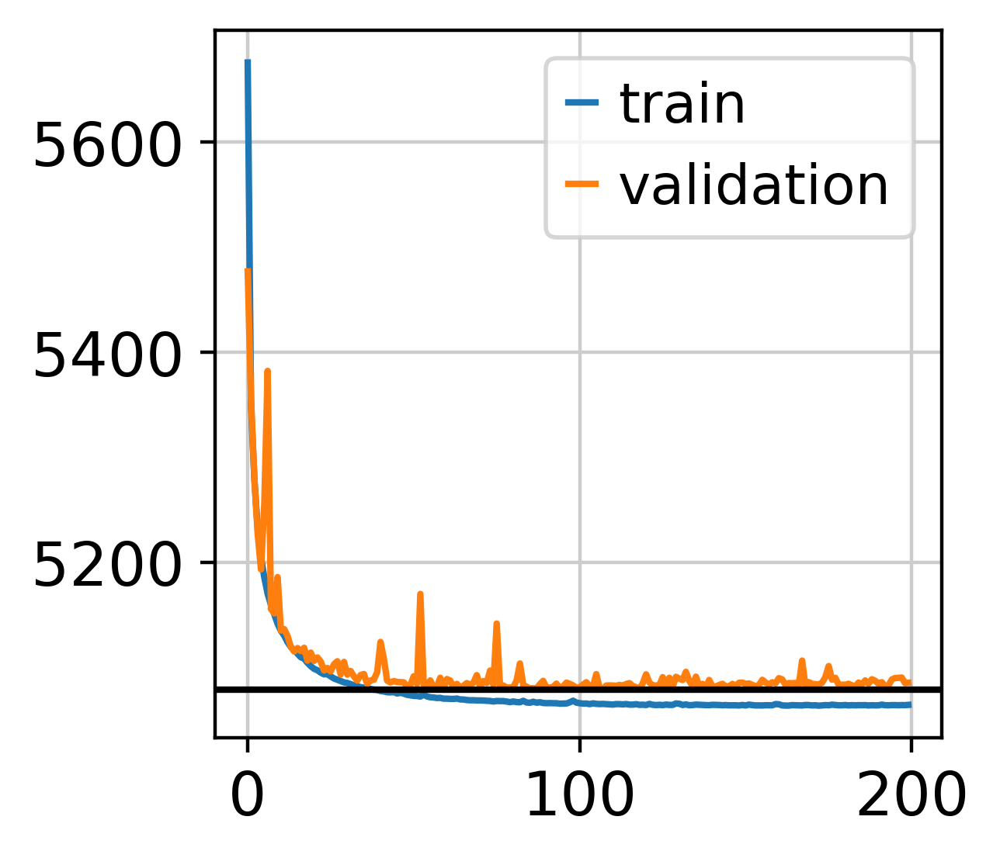

In [21]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')

plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [8]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_dbl.h5ad')
#model.save('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_dbl')
model = scvi.model.SCVI.load('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_dbl/', adata)
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/temp_pbmc_myeloid_platelet_dbl.h5ad')

INFO     File /media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_scvi_integration_model_dbl/model.pt    
         already downloaded                                                                                        


In [9]:
adata.obsm['X_scVI'] = model.get_latent_representation()
scvi_norm_count = model.get_normalized_expression(library_size = 1e4)
adata.layers['scvi_normalized'] = scvi_norm_count

In [10]:
sc.pp.neighbors(adata, use_rep = 'X_scVI', random_state = 123)
sc.tl.umap(adata)

In [11]:
sc.tl.leiden(adata, resolution = 2, key_added = 'overcluster')

In [172]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')

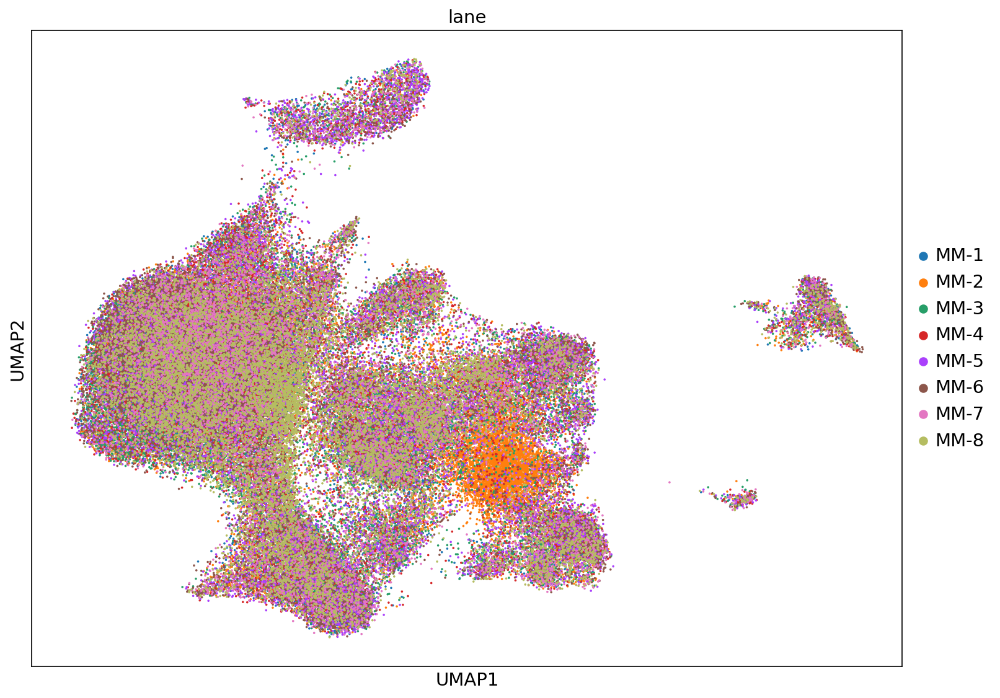

In [211]:
sc.pl.umap(adata, color = 'lane', size = 12, legend_fontsize = 'medium')

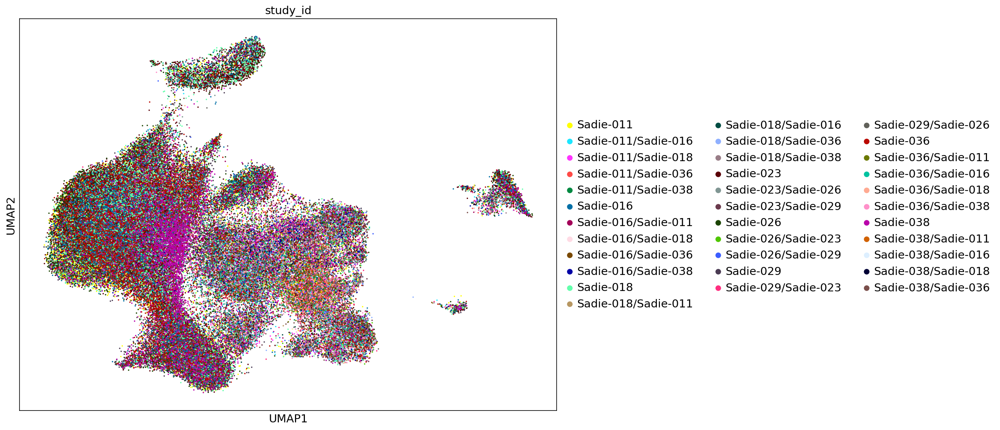

In [212]:
sc.pl.umap(adata, color = 'study_id', size = 12, legend_fontsize = 'medium')

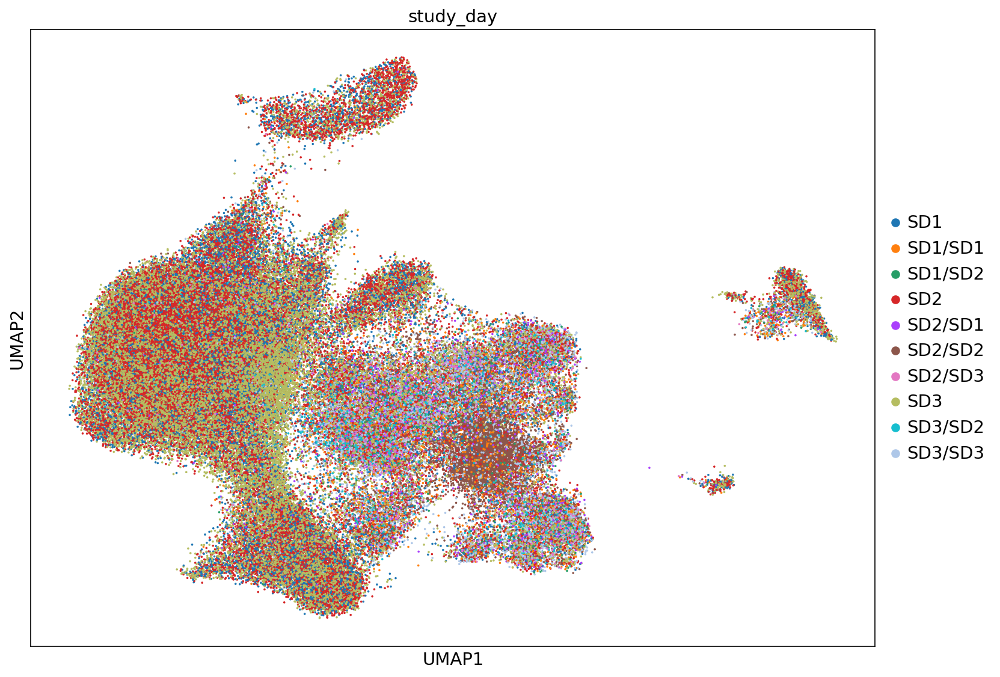

In [213]:
sc.pl.umap(adata, color = 'study_day', size = 12, legend_fontsize = 'medium')

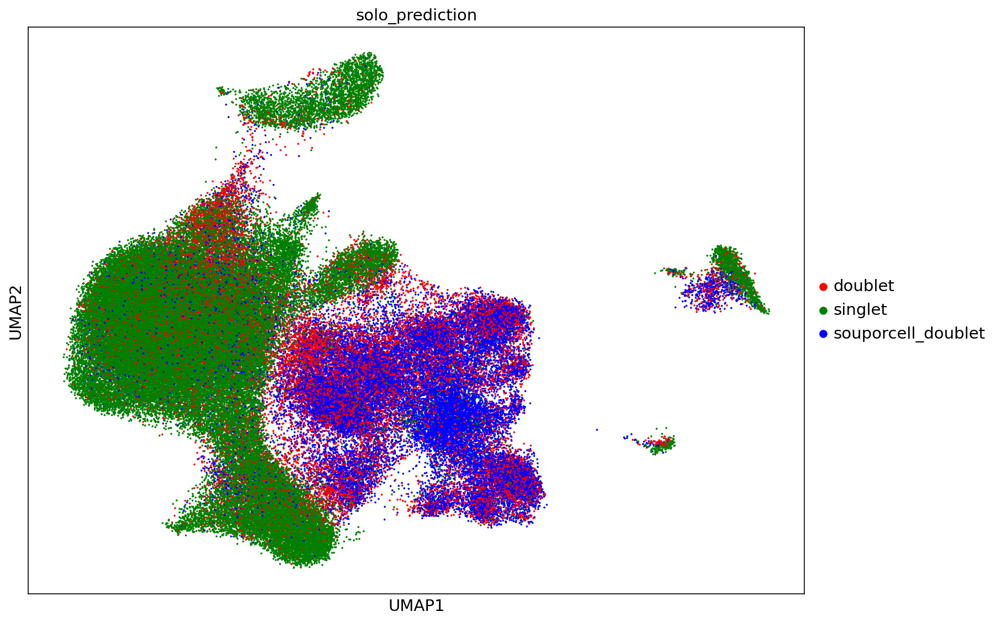

In [218]:
sc.pl.umap(adata, color = 'solo_prediction', size = 12, legend_fontsize = 'medium', palette = ['red','green','blue'])

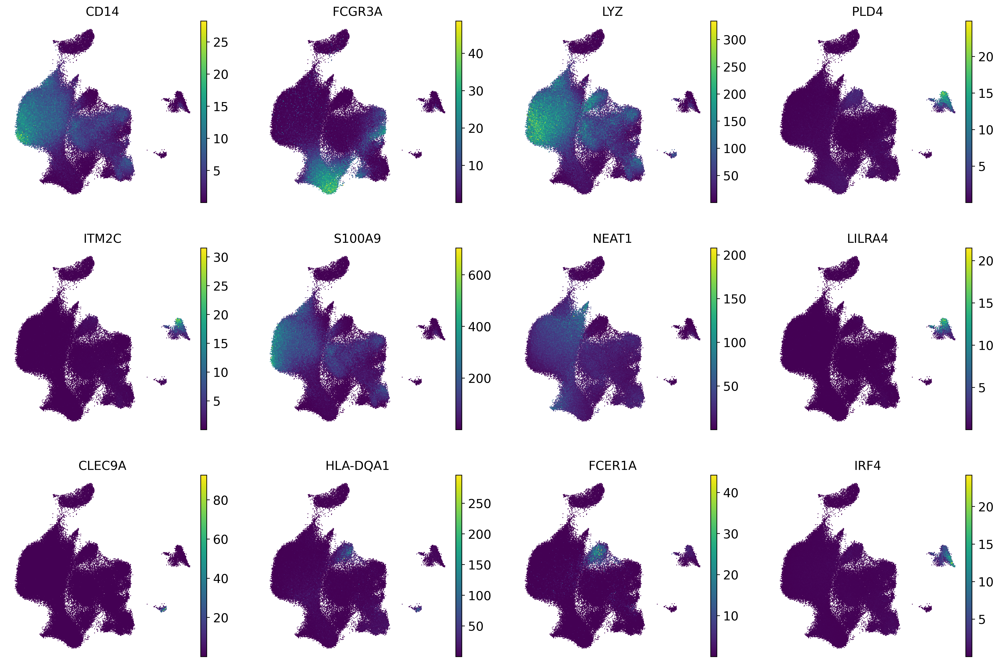

In [177]:
sc.set_figure_params(dpi=200)

sc.pl.umap(adata, color = ['CD14','FCGR3A','LYZ','PLD4','ITM2C','S100A9','NEAT1','LILRA4','CLEC9A','HLA-DQA1','FCER1A','IRF4'], size = 4, frameon = False, layer = 'scvi_normalized')

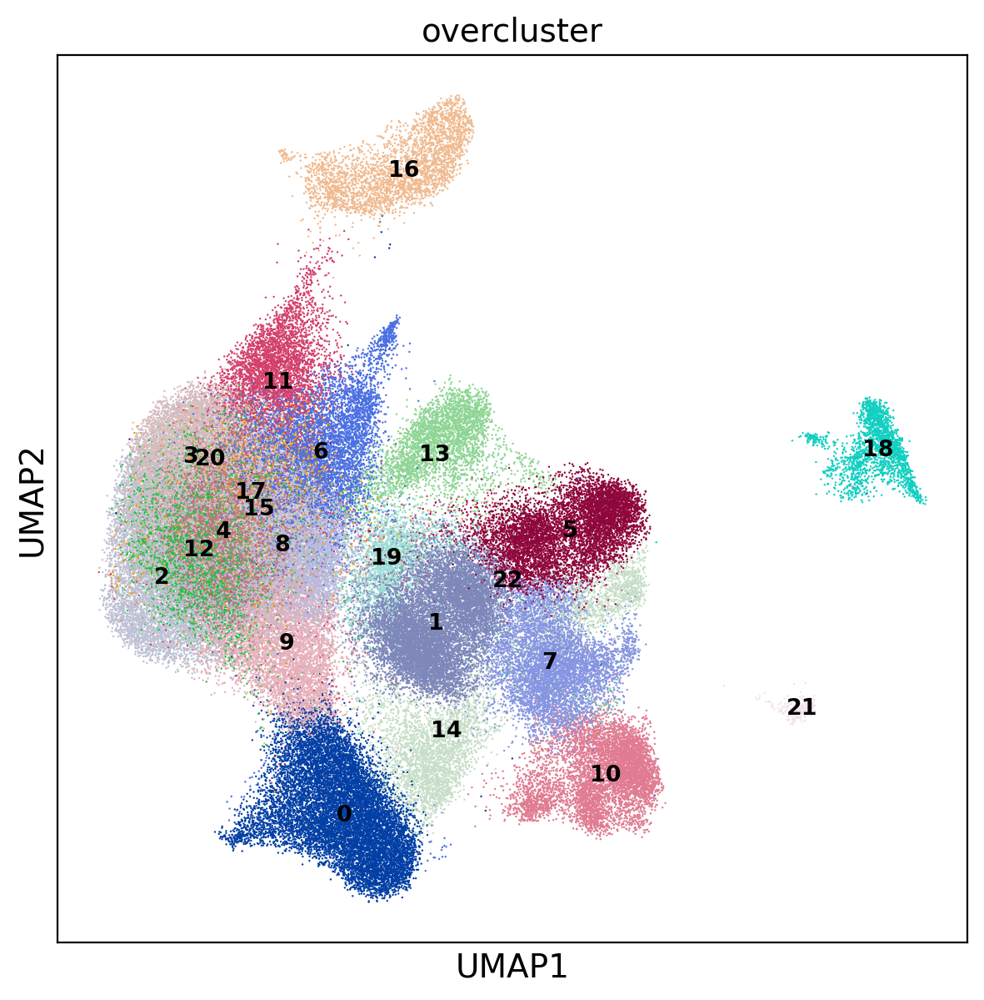

In [178]:
sc.set_figure_params(dpi=100)
plt.rcParams['figure.figsize'] = [7,7]
sc.pl.umap(adata, color = ['overcluster'], legend_loc = 'on data', size = 3, layer = 'scvi_normalized', legend_fontsize = 'x-small')

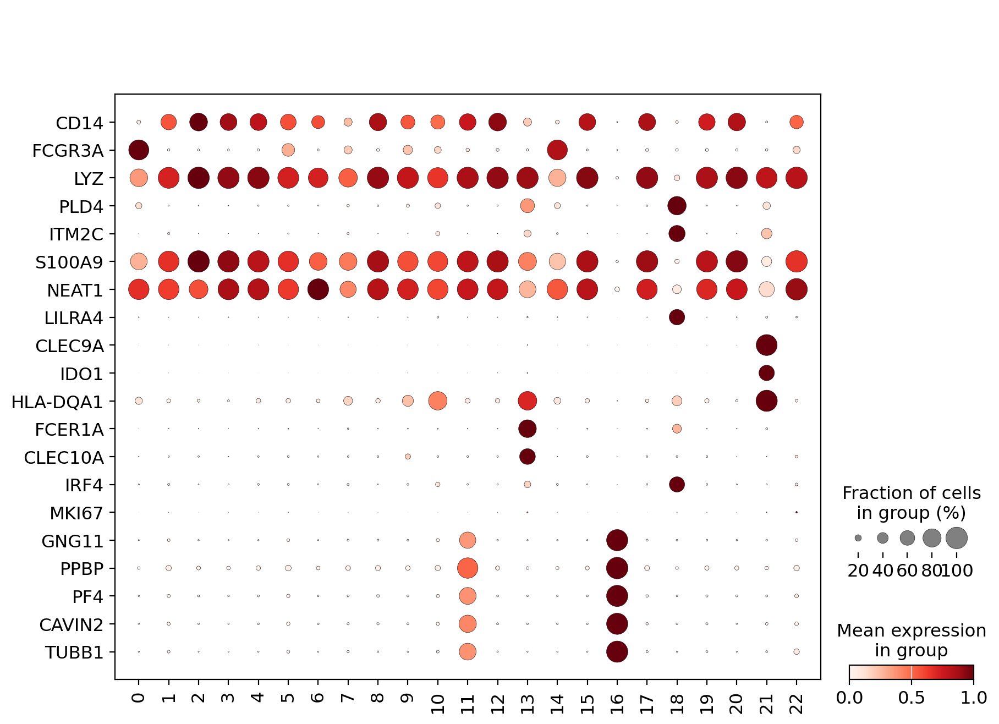

In [179]:
sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, ['CD14','FCGR3A','LYZ','PLD4','ITM2C','S100A9','NEAT1','LILRA4','CLEC9A','IDO1','HLA-DQA1','FCER1A','CLEC10A','IRF4','MKI67','GNG11','PPBP','PF4','CAVIN2','TUBB1'], groupby = 'overcluster', swap_axes = True,
              use_raw = True, standard_scale = 'var', dendrogram = False)

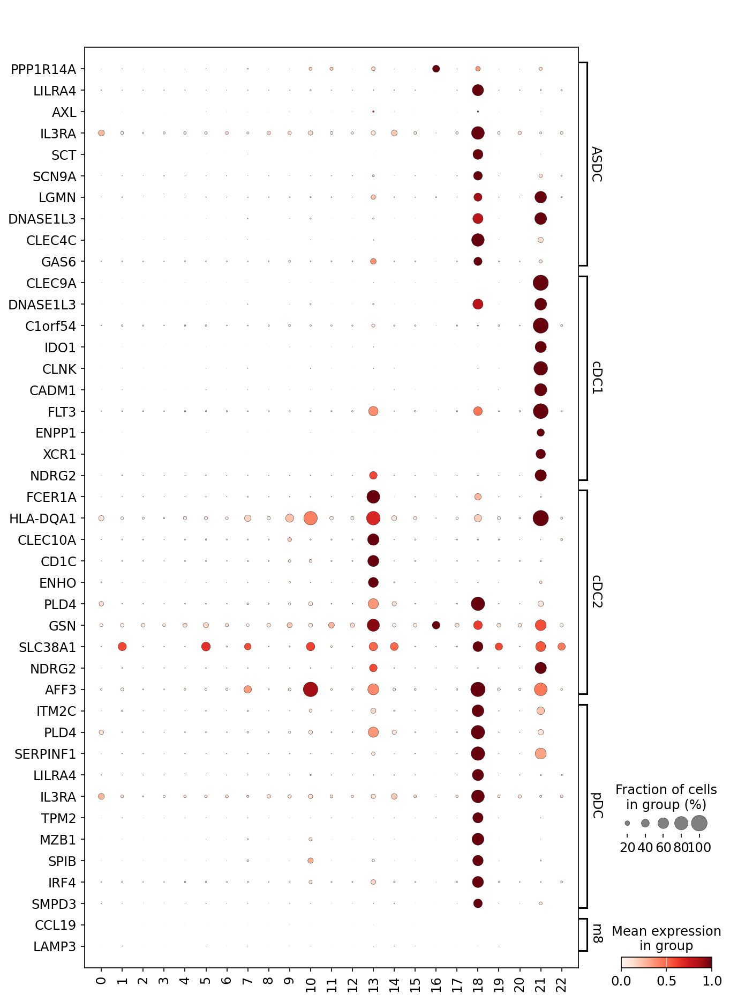

In [180]:
asdc = ['PPP1R14A', 'LILRA4', 'AXL', 'IL3RA', 'SCT', 'SCN9A', 'LGMN', 'DNASE1L3', 'CLEC4C', 'GAS6']
cdc1 = ['CLEC9A', 'DNASE1L3', 'C1orf54', 'IDO1', 'CLNK', 'CADM1', 'FLT3', 'ENPP1', 'XCR1', 'NDRG2']
cdc2 = ['FCER1A', 'HLA-DQA1', 'CLEC10A', 'CD1C', 'ENHO', 'PLD4', 'GSN', 'SLC38A1', 'NDRG2', 'AFF3']
pdc = ['ITM2C', 'PLD4', 'SERPINF1', 'LILRA4', 'IL3RA', 'TPM2', 'MZB1', 'SPIB', 'IRF4', 'SMPD3']
#np.concatenate((asdc,cdc1,cdc2,pdc))
sc.set_figure_params(dpi=75)
sc.pl.dotplot(adata, {'ASDC': asdc, 'cDC1': cdc1, 'cDC2': cdc2, 'pDC': pdc, 'm8': ['CCL19','LAMP3']}, groupby = 'overcluster', swap_axes = True,
              use_raw = True, standard_scale = 'var', dendrogram = False)

In [181]:
adata_singlet = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_final.h5ad')
mplate_bc = adata_singlet.obs[adata_singlet.obs['cell_type']=='M-platelet']['barcode_2']
adata.obs[adata.obs['barcode_2'].isin(mplate_bc)]['overcluster'].value_counts()

overcluster
11    2411
8      205
2      185
4      163
9      155
3      121
6      109
15      59
17      51
12      51
13      24
0       14
16       8
10       3
19       3
20       1
1        0
5        0
7        0
14       0
18       0
21       0
22       0
Name: count, dtype: int64

In [182]:
sc.tl.rank_genes_groups(adata, groupby='overcluster', method='t-test')

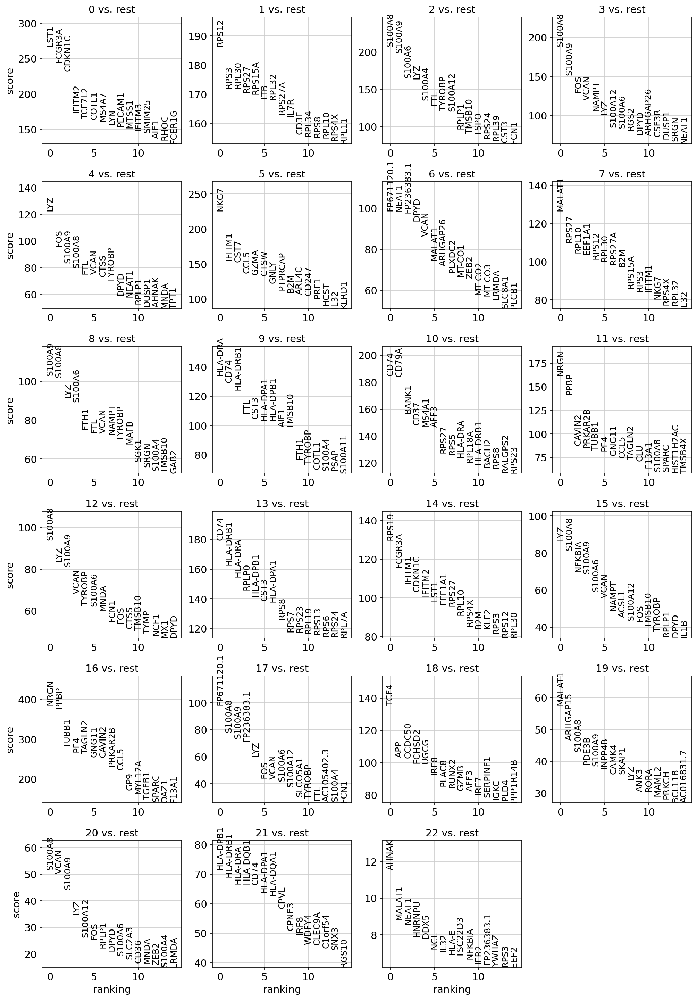

In [183]:
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, fontsize = 12)

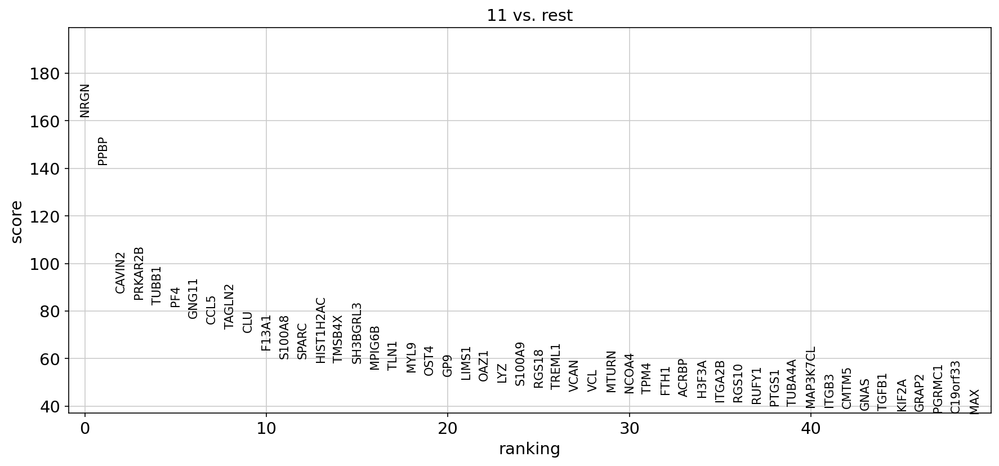

In [184]:
plt.rcParams['figure.figsize'] = [14, 6] # width, height
sc.pl.rank_genes_groups(adata, n_genes=50, groups=['11'], sharey=False, fontsize = 10)

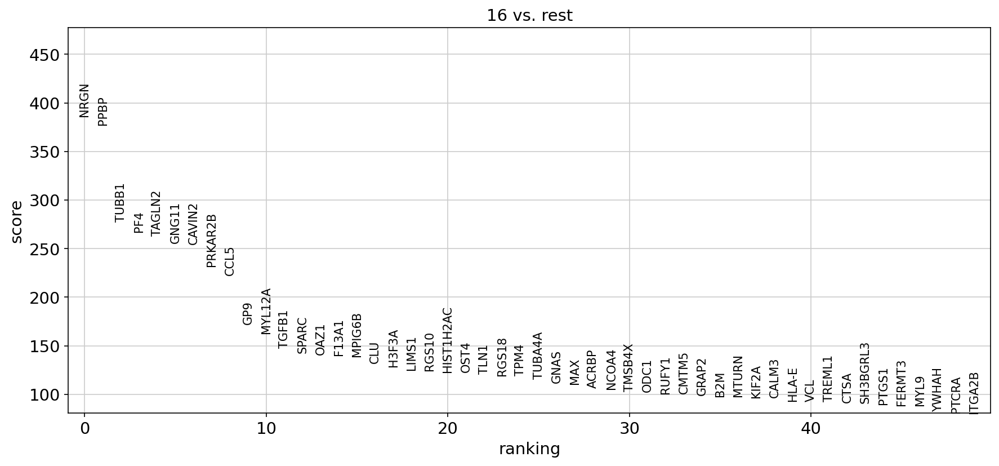

In [185]:
sc.pl.rank_genes_groups(adata, n_genes=50, groups=['16'], sharey=False, fontsize = 10)

In [186]:
adata.obs['ann_types'] = ['cMo' if x in [str(x) for x in [9,2,4,12,8,15,17,20,3,6]] else x for x in adata.obs['overcluster']]
adata.obs['ann_types'] = ['nMo' if x=='0' else x for x in adata.obs['ann_types']]
adata.obs['ann_types'] = ['MPA' if x=='11' else x for x in adata.obs['ann_types']]
adata.obs['ann_types'] = ['Platelet' if x=='16' else x for x in adata.obs['ann_types']]
adata.obs['ann_types'] = ['cDC1' if x=='21' else x for x in adata.obs['ann_types']]
adata.obs['ann_types'] = ['cDC2' if x=='13' else x for x in adata.obs['ann_types']]
adata.obs['ann_types'] = ['pDC' if x=='18' else x for x in adata.obs['ann_types']]

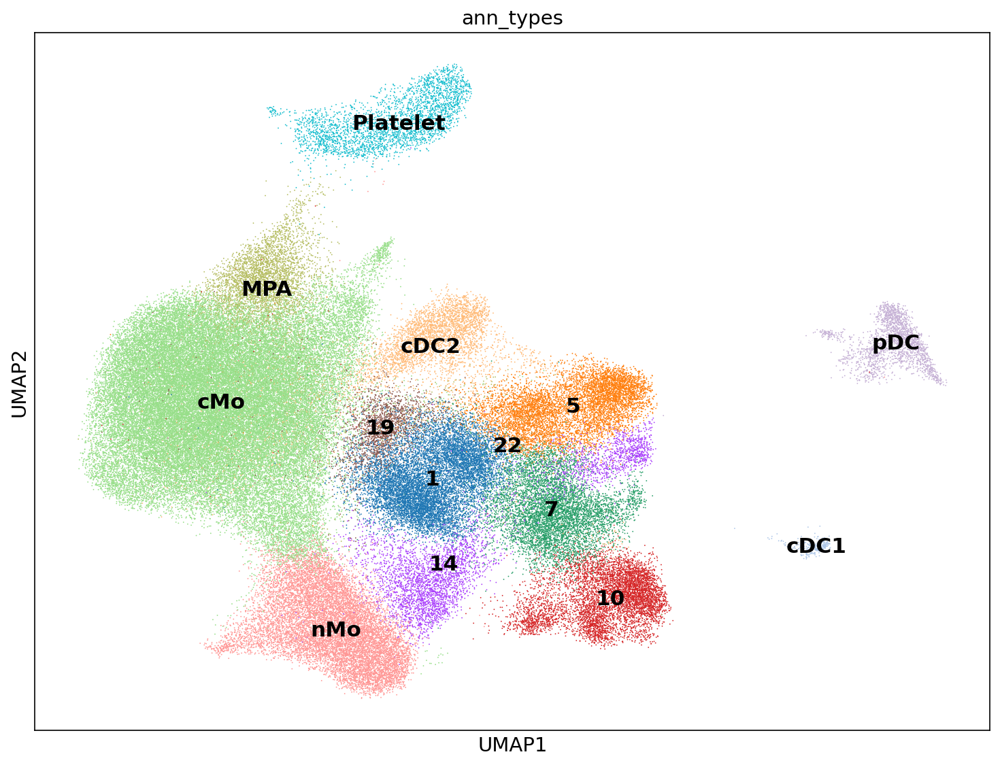

In [187]:
plt.rcParams['figure.figsize'] = [12, 9]
sc.pl.umap(adata, color = ['ann_types'], legend_loc = 'on data', size = 3, legend_fontsize = 15)

In [188]:
adata_mpa_platelet = adata[adata.obs['ann_types'].isin(['MPA','Platelet'])]
sc.tl.rank_genes_groups(adata_mpa_platelet, groupby='ann_types', method='t-test')

# Extract the rank_genes_groups results from adata_mpa_platelet.uns
rank_genes_groups = adata_mpa_platelet.uns['rank_genes_groups']

# Extract the keys (metrics) and group names
keys = list(rank_genes_groups.keys())
group_names = rank_genes_groups['names'].dtype.names

# Initialize a list to store DataFrames
dfs = []

# Iterate over group names and combine data into a DataFrame
for group in group_names:
    group_data = {key: rank_genes_groups[key][group] for key in keys if key != 'params'}
    df_group = pd.DataFrame(group_data)
    df_group['group'] = group
    dfs.append(df_group)

# Concatenate all group DataFrames into a single DataFrame
all_groups_df = pd.concat(dfs, ignore_index=True)

mpa_vs_platelet = all_groups_df[all_groups_df['group']=='MPA']#.sort_values(by='logfoldchanges', ascending=False)
platelet_vs_mpa = all_groups_df[all_groups_df['group']=='Platelet']#.sort_values(by='logfoldchanges', ascending=False)
mpa_vs_platelet['reference_type'] = 'Platelet'

In [189]:
adata_mpa_nmo = adata[adata.obs['ann_types'].isin(['MPA','nMo'])]
sc.tl.rank_genes_groups(adata_mpa_nmo, groupby='ann_types', method='t-test')

# Extract the rank_genes_groups results from adata_mpa_nmo.uns
rank_genes_groups = adata_mpa_nmo.uns['rank_genes_groups']

# Extract the keys (metrics) and group names
keys = list(rank_genes_groups.keys())
group_names = rank_genes_groups['names'].dtype.names

# Initialize a list to store DataFrames
dfs = []

# Iterate over group names and combine data into a DataFrame
for group in group_names:
    group_data = {key: rank_genes_groups[key][group] for key in keys if key != 'params'}
    df_group = pd.DataFrame(group_data)
    df_group['group'] = group
    dfs.append(df_group)

# Concatenate all group DataFrames into a single DataFrame
all_groups_df = pd.concat(dfs, ignore_index=True)

mpa_vs_cd16mo = all_groups_df[all_groups_df['group']=='MPA']#.sort_values(by='logfoldchanges', ascending=False)
cd16mo_vs_mpa = all_groups_df[all_groups_df['group']=='nMo']#.sort_values(by='logfoldchanges', ascending=False)
mpa_vs_cd16mo['reference_group'] = 'CD16 Mono'

In [190]:
adata_mpa_cmo = adata[adata.obs['ann_types'].isin(['MPA','cMo'])]
sc.tl.rank_genes_groups(adata_mpa_cmo, groupby='ann_types', method='t-test')

# Extract the rank_genes_groups results from adata_mpa_cmo.uns
rank_genes_groups = adata_mpa_cmo.uns['rank_genes_groups']

# Extract the keys (metrics) and group names
keys = list(rank_genes_groups.keys())
group_names = rank_genes_groups['names'].dtype.names

# Initialize a list to store DataFrames
dfs = []

# Iterate over group names and combine data into a DataFrame
for group in group_names:
    group_data = {key: rank_genes_groups[key][group] for key in keys if key != 'params'}
    df_group = pd.DataFrame(group_data)
    df_group['group'] = group
    dfs.append(df_group)

# Concatenate all group DataFrames into a single DataFrame
all_groups_df = pd.concat(dfs, ignore_index=True)

mpa_vs_cd14mo = all_groups_df[all_groups_df['group']=='MPA']#.sort_values(by='logfoldchanges', ascending=False)
cd14mo_vs_mpa = all_groups_df[all_groups_df['group']=='cMo']#.sort_values(by='logfoldchanges', ascending=False)
mpa_vs_cd14mo['reference_group'] = 'CD14 Mono'

In [223]:
mpa_vs_platelet.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/MPA_vs_Platelet_scanpy_markers.csv', index=False)
pd.concat([mpa_vs_platelet.head(20),mpa_vs_platelet.tail(20)])

,names,scores,pvals,pvals_adj,logfoldchanges,group,reference_type
0,S100A6,218.877213,0.0,0.0,7.637042,MPA,Platelet
1,S100A8,216.463501,0.0,0.0,9.060104,MPA,Platelet
2,LYZ,215.959091,0.0,0.0,7.973956,MPA,Platelet
3,S100A4,194.950302,0.0,0.0,7.274730,MPA,Platelet
4,FOS,192.647186,0.0,0.0,7.463691,MPA,Platelet
5,CTSS,191.528336,0.0,0.0,7.132077,MPA,Platelet
6,S100A9,190.166321,0.0,0.0,8.223441,MPA,Platelet
7,TYROBP,189.298035,0.0,0.0,7.074490,MPA,Platelet
8,S100A11,173.127228,0.0,0.0,6.842271,MPA,Platelet
9,TMSB10,170.920990,0.0,0.0,6.528827,MPA,Platelet


In [224]:
mpa_vs_cd16mo.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/MPA_vs_CD16Mono_scanpy_markers.csv', index=False)
pd.concat([mpa_vs_cd16mo.head(20),mpa_vs_cd16mo.tail(20)])

,names,scores,pvals,pvals_adj,logfoldchanges,group,reference_group
0,NRGN,166.075928,0.0,0.0,4.984876,MPA,CD16 Mono
1,S100A8,163.200317,0.0,0.0,5.204810,MPA,CD16 Mono
2,PPBP,153.228134,0.0,0.0,7.255883,MPA,CD16 Mono
3,VCAN,145.752686,0.0,0.0,4.804513,MPA,CD16 Mono
4,LYZ,135.398651,0.0,0.0,3.361530,MPA,CD16 Mono
5,S100A9,127.380409,0.0,0.0,3.827461,MPA,CD16 Mono
6,S100A12,104.808281,0.0,0.0,5.910922,MPA,CD16 Mono
7,CCL5,101.037849,0.0,0.0,5.795314,MPA,CD16 Mono
8,CAVIN2,96.214287,0.0,0.0,6.677263,MPA,CD16 Mono
9,PRKAR2B,90.985008,0.0,0.0,5.128253,MPA,CD16 Mono


In [225]:
mpa_vs_cd14mo.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/MPA_vs_CD14Mono_scanpy_markers.csv', index=False)
pd.concat([mpa_vs_cd14mo.head(20),mpa_vs_cd14mo.tail(20)])

,names,scores,pvals,pvals_adj,logfoldchanges,group,reference_group
0,NRGN,162.846405,0.000000e+00,0.000000e+00,4.270222,MPA,CD14 Mono
1,PPBP,151.159195,0.000000e+00,0.000000e+00,6.351900,MPA,CD14 Mono
2,CCL5,100.833466,0.000000e+00,0.000000e+00,5.359333,MPA,CD14 Mono
3,CAVIN2,95.387222,0.000000e+00,0.000000e+00,5.979140,MPA,CD14 Mono
4,PRKAR2B,93.054291,0.000000e+00,0.000000e+00,5.259846,MPA,CD14 Mono
5,TUBB1,90.946922,0.000000e+00,0.000000e+00,6.514905,MPA,CD14 Mono
6,PF4,89.504387,0.000000e+00,0.000000e+00,5.801735,MPA,CD14 Mono
7,GNG11,85.004448,0.000000e+00,0.000000e+00,6.111849,MPA,CD14 Mono
8,TAGLN2,79.742950,0.000000e+00,0.000000e+00,1.845326,MPA,CD14 Mono
9,CLU,77.790039,0.000000e+00,0.000000e+00,5.548079,MPA,CD14 Mono


In [194]:
# Convert 'overcluster' column to integer for processing
overcluster_int = adata.obs['overcluster'].astype(int)

# Get unique clusters sorted in ascending order
unique_clusters = sorted(overcluster_int.unique())

# Initialize lists to store the calculated frequencies
singlet_freqs = []
doublet_freqs = []
souporcell_doublet_freqs = []
doublet_sum_freqs = []

# Calculate frequencies for each cluster
for cluster in unique_clusters:
    cluster_data = adata.obs[overcluster_int == cluster]
    total_cells = len(cluster_data)
    
    singlet_freq = (cluster_data['solo_prediction'] == 'singlet').sum() / total_cells * 100
    doublet_freq = (cluster_data['solo_prediction'] == 'doublet').sum() / total_cells * 100
    souporcell_doublet_freq = (cluster_data['solo_prediction'] == 'souporcell_doublet').sum() / total_cells * 100
    doublet_sum_freq = doublet_freq + souporcell_doublet_freq
    
    singlet_freqs.append(singlet_freq)
    doublet_freqs.append(doublet_freq)
    souporcell_doublet_freqs.append(souporcell_doublet_freq)
    doublet_sum_freqs.append(doublet_sum_freq)

# Calculate overall frequencies
total_cells = len(adata.obs)
overall_singlet_freq = (adata.obs['solo_prediction'] == 'singlet').sum() / total_cells * 100
overall_doublet_freq = (adata.obs['solo_prediction'] == 'doublet').sum() / total_cells * 100
overall_souporcell_doublet_freq = (adata.obs['solo_prediction'] == 'souporcell_doublet').sum() / total_cells * 100

# Create the DataFrame for clusters
report_df = pd.DataFrame({
    'overcluster': [str(cluster) for cluster in unique_clusters],
    'singlet': singlet_freqs,
    'doublet': doublet_freqs,
    'souporcell_doublet': souporcell_doublet_freqs,
    'doublet_sum': doublet_sum_freqs
})

# Add overall frequencies to the DataFrame
overall_df = pd.DataFrame({
    'overcluster': ['overall'],
    'singlet': [overall_singlet_freq],
    'doublet': [overall_doublet_freq],
    'souporcell_doublet': [overall_souporcell_doublet_freq],
    'doublet_sum': [overall_doublet_freq + overall_souporcell_doublet_freq]
})

# Use pd.concat to append the overall frequencies to the report DataFrame
final_report_df = pd.concat([report_df, overall_df], ignore_index=True)

print(final_report_df)

   overcluster    singlet    doublet  souporcell_doublet  doublet_sum
0            0  85.887504  10.028629            4.083867    14.112496
1            1   1.359186  36.051706           62.589107    98.640814
2            2  89.977163   6.724182            3.298655    10.022837
3            3  86.537713   9.308062            4.154226    13.462287
4            4  88.927723   8.905354            2.166923    11.072277
5            5   1.147612  35.647683           63.204705    98.852388
6            6  84.228972  11.623832            4.147196    15.771028
7            7   4.720774  11.332837           83.946389    95.279226
8            8  82.595541  12.165605            5.238854    17.404459
9            9  86.424004   9.854074            3.721922    13.575996
10          10   1.944948  36.360640           61.694412    98.055052
11          11  54.626005  35.338966           10.035030    45.373995
12          12  80.334728  15.783357            3.881915    19.665272
13          13  69.8

In [195]:
np.mean(adata.obs['solo_prediction']=='doublet') * 100

19.429101598064634

In [196]:
np.mean(adata.obs['solo_prediction']=='souporcell_doublet') * 100

23.817492868105475

In [197]:
overall_rate = final_report_df.iloc[np.where(final_report_df['overcluster']=='overall')]
cluster_rate = final_report_df.iloc[np.where(final_report_df['overcluster']!='overall')]

In [198]:
# Extract overall rates for singlet, doublet, and souporcell_doublet
overall_singlet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'singlet'].values[0]
overall_doublet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'doublet'].values[0]
overall_souporcell_doublet = overall_rate.loc[overall_rate['overcluster'] == 'overall', 'souporcell_doublet'].values[0]

# Subtract overall rates from each corresponding column in cluster_rate
new_cluster_rate = cluster_rate.copy()
new_cluster_rate['singlet'] = cluster_rate['singlet'] - overall_singlet
new_cluster_rate['doublet'] = cluster_rate['doublet'] - overall_doublet
new_cluster_rate['souporcell_doublet'] = cluster_rate['souporcell_doublet'] - overall_souporcell_doublet

print(new_cluster_rate)

   overcluster    singlet    doublet  souporcell_doublet  doublet_sum
0            0  29.134099  -9.400472          -19.733626    14.112496
1            1 -55.394219  16.622605           38.771615    98.640814
2            2  33.223758 -12.704920          -20.518838    10.022837
3            3  29.784307 -10.121040          -19.663267    13.462287
4            4  32.174317 -10.523747          -21.650570    11.072277
5            5 -55.605794  16.218582           39.387212    98.852388
6            6  27.475566  -7.805270          -19.670297    15.771028
7            7 -52.032631  -8.096265           60.128896    95.279226
8            8  25.842136  -7.263497          -18.578639    17.404459
9            9  29.670598  -9.575027          -20.095571    13.575996
10          10 -54.808457  16.931538           37.876920    98.055052
11          11  -2.127401  15.909864          -13.782463    45.373995
12          12  23.581322  -3.645745          -19.935577    19.665272
13          13  13.1

In [199]:
myl_singlet_rate_map = new_cluster_rate.set_index('overcluster')['singlet'].to_dict()
myl_doublet_rate_map = new_cluster_rate.set_index('overcluster')['doublet'].to_dict()
myl_souporcell_doublet_rate_map = new_cluster_rate.set_index('overcluster')['souporcell_doublet'].to_dict()
myl_sum_doublet_rate_map = new_cluster_rate.set_index('overcluster')['doublet_sum'].to_dict()
adata.obs['singlet_frequency'] = adata.obs['overcluster'].map(myl_singlet_rate_map)
adata.obs['doublet_frequency'] = adata.obs['overcluster'].map(myl_doublet_rate_map)
adata.obs['souporcell_doublet_frequency'] = adata.obs['overcluster'].map(myl_souporcell_doublet_rate_map)
adata.obs['doublet_sum_frequency'] = adata.obs['overcluster'].map(myl_sum_doublet_rate_map)
type(adata.obs['singlet_frequency'][0])

numpy.float64

In [200]:
myl_singlet_rate_map = new_cluster_rate.set_index('overcluster')['singlet'].to_dict()
myl_doublet_rate_map = new_cluster_rate.set_index('overcluster')['doublet'].to_dict()
myl_souporcell_doublet_rate_map = new_cluster_rate.set_index('overcluster')['souporcell_doublet'].to_dict()
myl_sum_doublet_rate_map = new_cluster_rate.set_index('overcluster')['doublet_sum'].to_dict()

In [201]:
adata.obs['singlet_frequency'] = adata.obs['overcluster'].map(myl_singlet_rate_map).astype(float)
adata.obs['doublet_frequency'] = adata.obs['overcluster'].map(myl_doublet_rate_map).astype(float)
adata.obs['souporcell_doublet_frequency'] = adata.obs['overcluster'].map(myl_souporcell_doublet_rate_map).astype(float)
adata.obs['doublet_sum_frequency'] = adata.obs['overcluster'].map(myl_sum_doublet_rate_map).astype(float)

In [202]:
type(adata.obs['singlet_frequency'][0])

numpy.float64

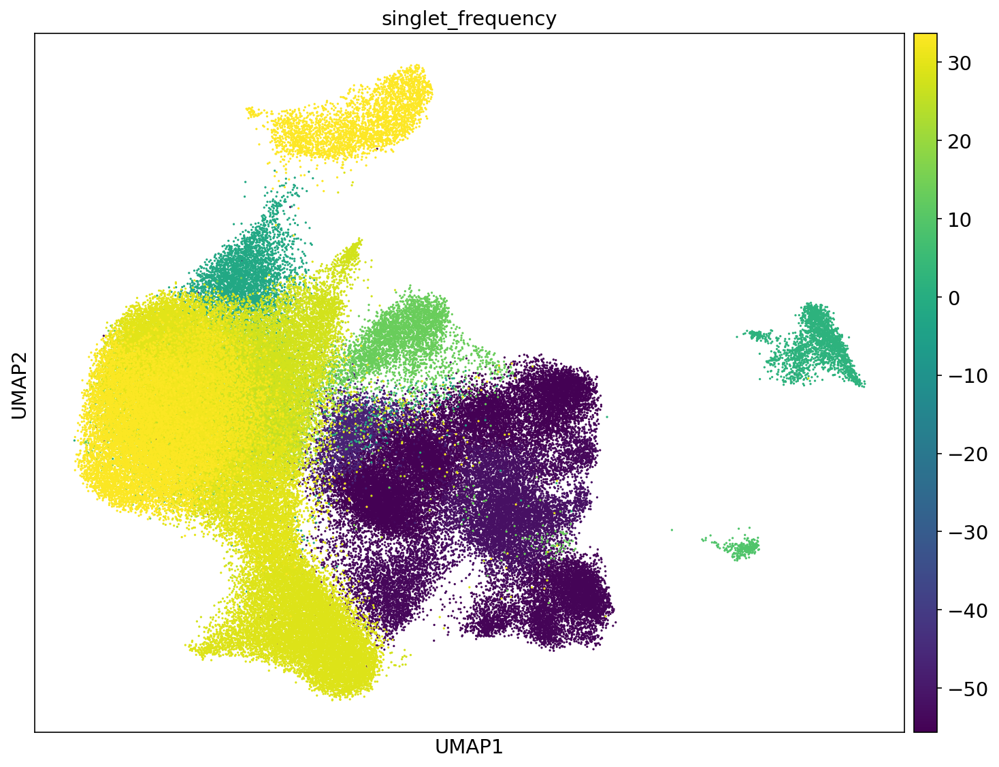

In [203]:
sc.pl.umap(adata, color = 'singlet_frequency', size = 10)

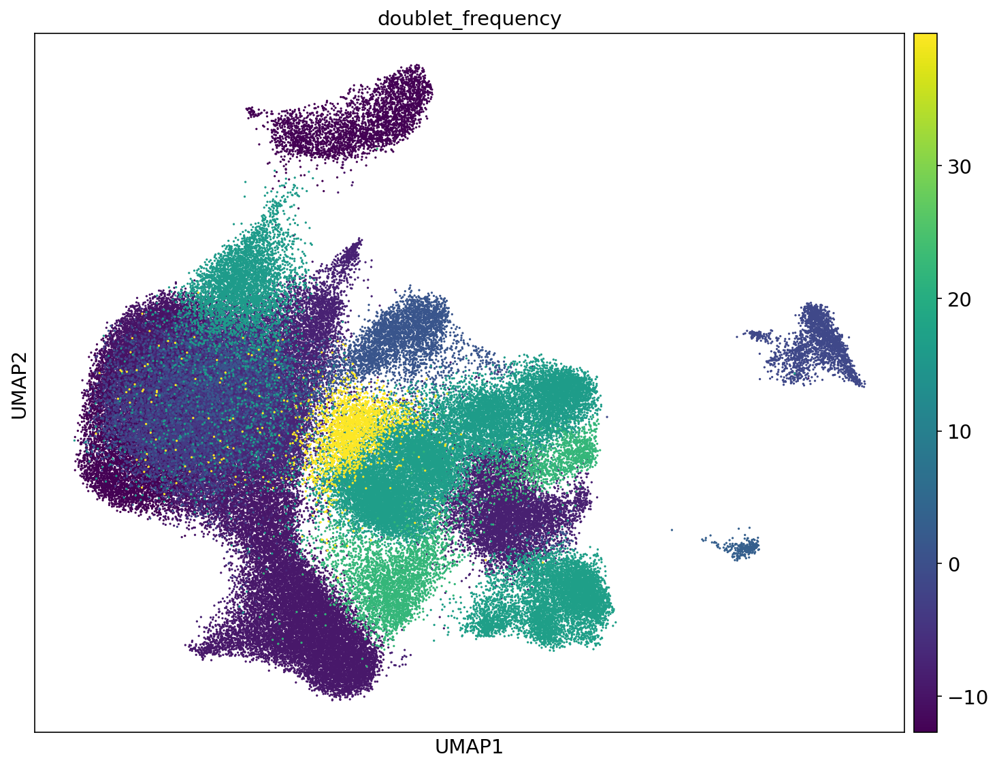

In [204]:
sc.pl.umap(adata, color = 'doublet_frequency', size = 10)

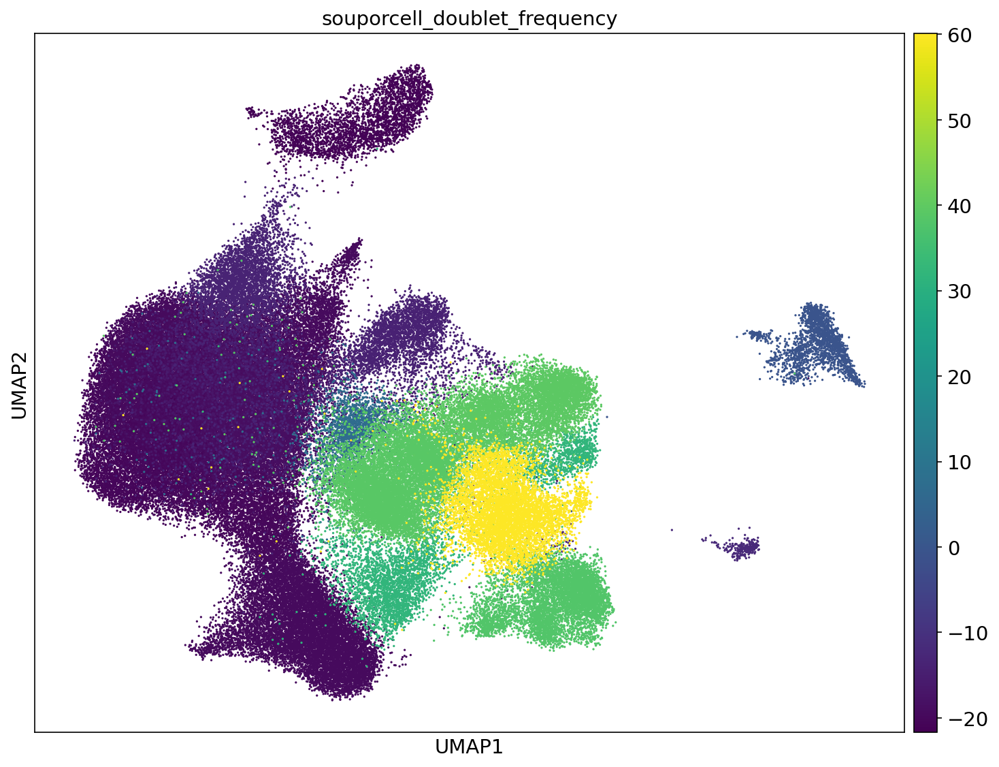

In [205]:
sc.pl.umap(adata, color = 'souporcell_doublet_frequency', size = 10)

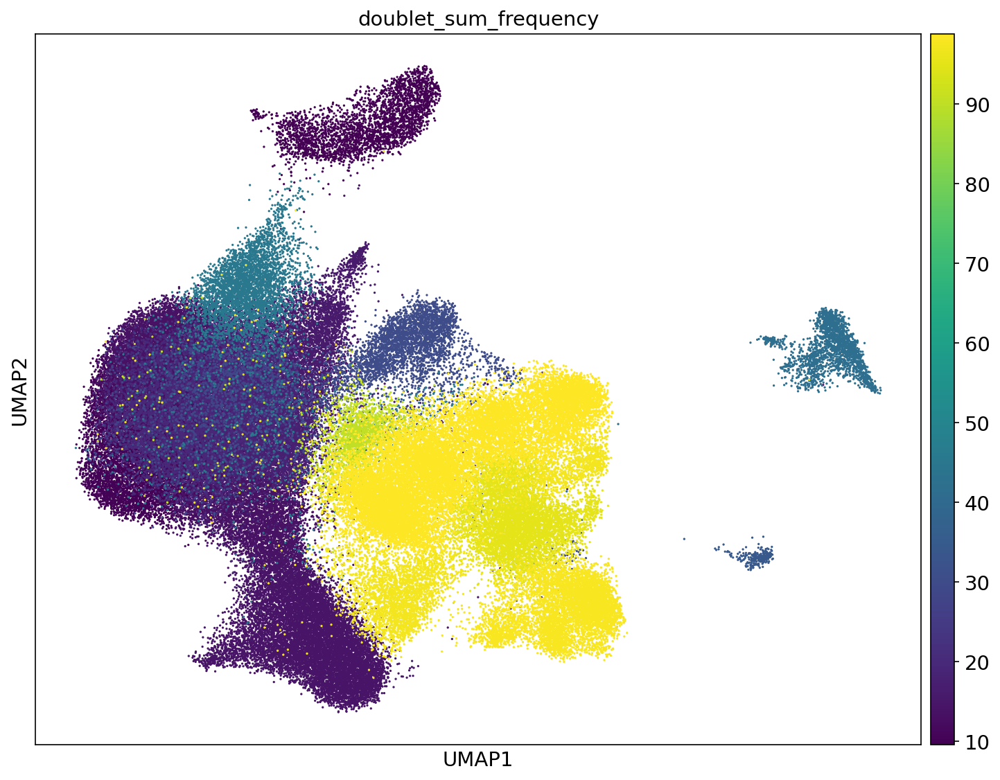

In [206]:
sc.pl.umap(adata, color = 'doublet_sum_frequency', size = 10)

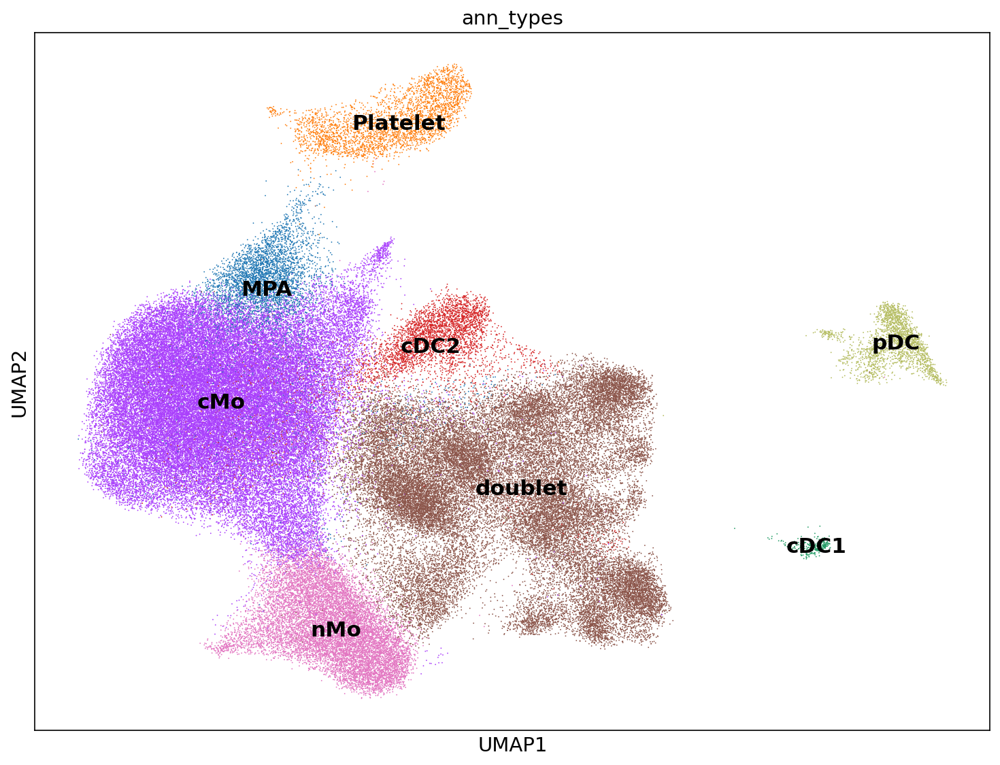

In [207]:
adata.obs['ann_types'] = ['doublet' if x in [str(x) for x in [19,1,22,5,14,7,10]] else x for x in adata.obs['ann_types']]
plt.rcParams['figure.figsize'] = [12, 9]
sc.pl.umap(adata, color = ['ann_types'], legend_loc = 'on data', size = 3, legend_fontsize = 15)

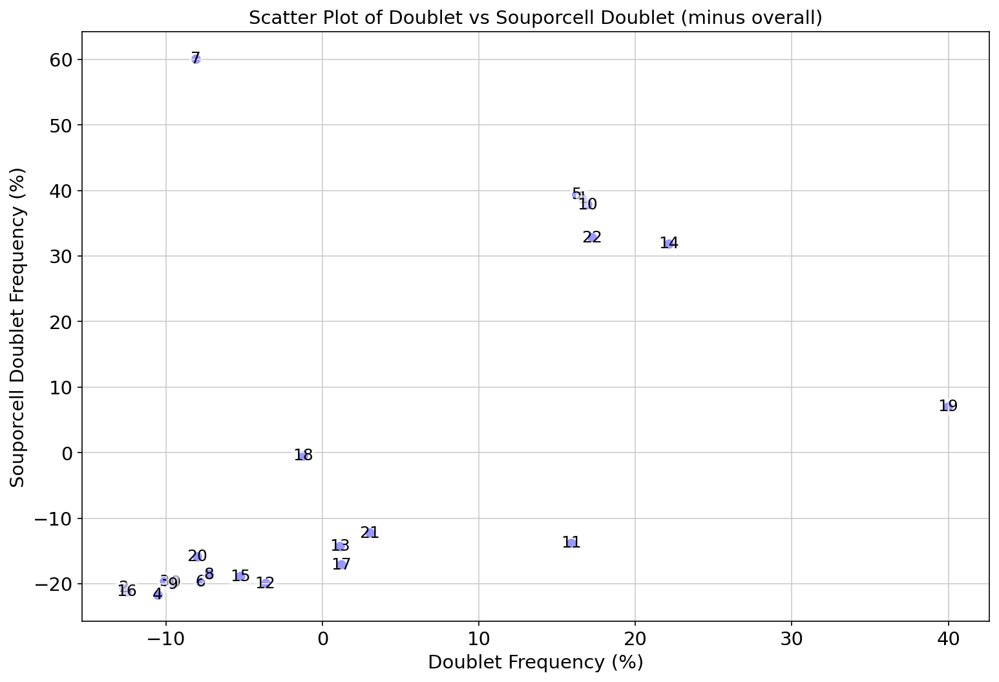

In [208]:
# Create scatter plot
plt.figure(figsize=(12, 8))
plt.scatter(new_cluster_rate['doublet'], new_cluster_rate['souporcell_doublet'], color='blue')

# Add labels to each data point
for i, row in new_cluster_rate.iterrows():
    plt.text(row['doublet'], row['souporcell_doublet'], row['overcluster'], fontsize=12, ha='center', va='center',
             bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', pad=1))

# Add titles and labels
plt.title('Scatter Plot of Doublet vs Souporcell Doublet (minus overall)')
plt.xlabel('Doublet Frequency (%)')
plt.ylabel('Souporcell Doublet Frequency (%)')

# Show plot
plt.grid(True)
plt.show()

In [219]:
#adata.write_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')

In [8]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')

In [ ]:
np.savetxt('/media/MPEdge16/MM137/sc/py/py_out/pbmc_myeloid_platelet_int_dbl_umap_coordinates_to_r.csv', adata.obsm['X_umap'], delimiter = ',')
adata.obs[['barcode_2','ann_types','souporcell_status','study_id','study_day','solo_prediction','doublet_frequency','souporcell_doublet_frequency',
           'doublet_sum_frequency']].to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc_myeloid_platelet_int_dbl_obs_to_r.csv', index=False)

In [15]:
?adata.obs.to_csv

Signature:
adata.obs.to_csv(
    path_or_buf: 'FilePath | WriteBuffer[bytes] | WriteBuffer[str] | None' = None,
    *,
    sep: 'str' = ',',
    na_rep: 'str' = '',
    float_format: 'str | Callable | None' = None,
    columns: 'Sequence[Hashable] | None' = None,
    header: 'bool_t | list[str]' = True,
    index: 'bool_t' = True,
    index_label: 'IndexLabel | None' = None,
    mode: 'str' = 'w',
    encoding: 'str | None' = None,
    compression: 'CompressionOptions' = 'infer',
    quoting: 'int | None' = None,
    quotechar: 'str' = '"',
    lineterminator: 'str | None' = None,
    chunksize: 'int | None' = None,
    date_format: 'str | None' = None,
    doublequote: 'bool_t' = True,
    escapechar: 'str | None' = None,
    decimal: 'str' = '.',
    errors: 'OpenFileErrors' = 'strict',
    storage_options: 'StorageOptions | None' = None,
) -> 'str | None'
Docstring:
Write object to a comma-separated values (csv) file.

Parameters
----------
path_or_buf : str, path object, file-like 

In [220]:
adata.obs

,lane,souporcell_status,souporcell_assignment,study_id,barcode_2,map_sd,study_day,solo_prediction,n_genes,n_genes_by_counts,...,pct_counts_MT,_scvi_batch,_scvi_labels,overcluster,cell_group,ann_types,singlet_frequency,doublet_frequency,souporcell_doublet_frequency,doublet_sum_frequency
barcode_2,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGACGAA-1,MM-1,singlet,1,Sadie-018,AAACCTGAGAGACGAA-1,SADIE018_1,SD1,doublet,4599,4599,...,1.991979,0,0,18,Myeloid,pDC,1.655794,-1.221148,-0.434647,41.590800
AAACCTGAGAGGTTGC-1,MM-1,singlet,0,Sadie-011,AAACCTGAGAGGTTGC-1,SADIE011_1,SD1,singlet,1966,1966,...,3.757829,0,0,3,Myeloid,cMo,29.784307,-10.121040,-19.663267,13.462287
AAACCTGAGCTCAACT-1,MM-1,singlet,2,Sadie-016,AAACCTGAGCTCAACT-1,SADIE016_1,SD1,doublet,3335,3335,...,1.373366,0,0,1,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814
AAACCTGAGTCCGGTC-1,MM-1,singlet,2,Sadie-016,AAACCTGAGTCCGGTC-1,SADIE016_1,SD1,singlet,841,841,...,3.333333,0,0,6,Myeloid,cMo,27.475566,-7.805270,-19.670297,15.771028
AAACCTGCAATCTACG-1,MM-1,singlet,1,Sadie-018,AAACCTGCAATCTACG-1,SADIE018_1,SD1,singlet,1803,1803,...,1.777013,0,0,4,Myeloid,cMo,32.174317,-10.523747,-21.650570,11.072277
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCGTTGTC-8,MM-8,singlet,0,Sadie-036,TTTGTCATCCGTTGTC-8,SADIE036_8,SD3,doublet,1520,1520,...,6.228765,7,0,1,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814
TTTGTCATCGAGAACG-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGAGAACG-8,SADIE016_8,SD2,singlet,461,461,...,0.570776,7,0,16,Platelet,Platelet,33.677216,-12.507252,-21.169965,9.569378
TTTGTCATCGCATGGC-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGCATGGC-8,SADIE016_8,SD2,singlet,1818,1818,...,2.085286,7,0,15,Myeloid,cMo,24.089028,-5.232534,-18.856494,19.157566


In [209]:
#mmwrite('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_12_counts.mtx', adata_12.raw.X)
#adata_12.obs.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_12_obs.csv', index=False)
#adata_12.var.to_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_12_var.csv', index=True)

### alternate doublet assignment

In [8]:
adata = sc.read_h5ad('/media/MPEdge16/MM137/sc/py/py_out/pbmc/pbmc_myeloid_platelet_int_dbl.h5ad')
dbl = pd.read_csv('/media/MPEdge16/MM137/sc/py/py_out/pbmc/doublet_scores.csv')

In [18]:
dbl_solo = dict(zip(dbl['Barcode'], dbl['solo_DropletType']))
dbl_dd = dict(zip(dbl['Barcode'], dbl['DoubletDetection_DropletType']))
dbl_scr = dict(zip(dbl['Barcode'], dbl['scrublet_DropletType']))
dbl_scds = dict(zip(dbl['Barcode'], dbl['cxds_DropletType']))

In [12]:
adata.obs

,lane,souporcell_status,souporcell_assignment,study_id,barcode_2,map_sd,study_day,solo_prediction,n_genes,n_genes_by_counts,...,pct_counts_MT,_scvi_batch,_scvi_labels,overcluster,cell_group,ann_types,singlet_frequency,doublet_frequency,souporcell_doublet_frequency,doublet_sum_frequency
barcode_2,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGACGAA-1,MM-1,singlet,1,Sadie-018,AAACCTGAGAGACGAA-1,SADIE018_1,SD1,doublet,4599,4599,...,1.991979,0,0,18,Myeloid,pDC,1.655794,-1.221148,-0.434647,41.590800
AAACCTGAGAGGTTGC-1,MM-1,singlet,0,Sadie-011,AAACCTGAGAGGTTGC-1,SADIE011_1,SD1,singlet,1966,1966,...,3.757829,0,0,3,Myeloid,cMo,29.784307,-10.121040,-19.663267,13.462287
AAACCTGAGCTCAACT-1,MM-1,singlet,2,Sadie-016,AAACCTGAGCTCAACT-1,SADIE016_1,SD1,doublet,3335,3335,...,1.373366,0,0,1,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814
AAACCTGAGTCCGGTC-1,MM-1,singlet,2,Sadie-016,AAACCTGAGTCCGGTC-1,SADIE016_1,SD1,singlet,841,841,...,3.333333,0,0,6,Myeloid,cMo,27.475566,-7.805270,-19.670297,15.771028
AAACCTGCAATCTACG-1,MM-1,singlet,1,Sadie-018,AAACCTGCAATCTACG-1,SADIE018_1,SD1,singlet,1803,1803,...,1.777013,0,0,4,Myeloid,cMo,32.174317,-10.523747,-21.650570,11.072277
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCGTTGTC-8,MM-8,singlet,0,Sadie-036,TTTGTCATCCGTTGTC-8,SADIE036_8,SD3,doublet,1520,1520,...,6.228765,7,0,1,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814
TTTGTCATCGAGAACG-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGAGAACG-8,SADIE016_8,SD2,singlet,461,461,...,0.570776,7,0,16,Platelet,Platelet,33.677216,-12.507252,-21.169965,9.569378
TTTGTCATCGCATGGC-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGCATGGC-8,SADIE016_8,SD2,singlet,1818,1818,...,2.085286,7,0,15,Myeloid,cMo,24.089028,-5.232534,-18.856494,19.157566


In [20]:
adata.obs['dbl_solo'] = adata.obs['barcode_2'].map(dbl_solo)
adata.obs['dbl_doubletdetection'] = adata.obs['barcode_2'].map(dbl_dd)
adata.obs['dbl_scrublet'] = adata.obs['barcode_2'].map(dbl_scr)
adata.obs['dbl_scds'] = adata.obs['barcode_2'].map(dbl_scds)

In [21]:
adata.obs

,lane,souporcell_status,souporcell_assignment,study_id,barcode_2,map_sd,study_day,solo_prediction,n_genes,n_genes_by_counts,...,cell_group,ann_types,singlet_frequency,doublet_frequency,souporcell_doublet_frequency,doublet_sum_frequency,dbl_solo,dbl_doubletdetection,dbl_scrublet,dbl_scds
barcode_2,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGACGAA-1,MM-1,singlet,1,Sadie-018,AAACCTGAGAGACGAA-1,SADIE018_1,SD1,doublet,4599,4599,...,Myeloid,pDC,1.655794,-1.221148,-0.434647,41.590800,doublet,singlet,singlet,singlet
AAACCTGAGAGGTTGC-1,MM-1,singlet,0,Sadie-011,AAACCTGAGAGGTTGC-1,SADIE011_1,SD1,singlet,1966,1966,...,Myeloid,cMo,29.784307,-10.121040,-19.663267,13.462287,singlet,singlet,singlet,singlet
AAACCTGAGCTCAACT-1,MM-1,singlet,2,Sadie-016,AAACCTGAGCTCAACT-1,SADIE016_1,SD1,doublet,3335,3335,...,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814,doublet,doublet,doublet,doublet
AAACCTGAGTCCGGTC-1,MM-1,singlet,2,Sadie-016,AAACCTGAGTCCGGTC-1,SADIE016_1,SD1,singlet,841,841,...,Myeloid,cMo,27.475566,-7.805270,-19.670297,15.771028,singlet,singlet,singlet,singlet
AAACCTGCAATCTACG-1,MM-1,singlet,1,Sadie-018,AAACCTGCAATCTACG-1,SADIE018_1,SD1,singlet,1803,1803,...,Myeloid,cMo,32.174317,-10.523747,-21.650570,11.072277,singlet,singlet,singlet,singlet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCGTTGTC-8,MM-8,singlet,0,Sadie-036,TTTGTCATCCGTTGTC-8,SADIE036_8,SD3,doublet,1520,1520,...,Myeloid,doublet,-55.394219,16.622605,38.771615,98.640814,doublet,doublet,doublet,doublet
TTTGTCATCGAGAACG-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGAGAACG-8,SADIE016_8,SD2,singlet,461,461,...,Platelet,Platelet,33.677216,-12.507252,-21.169965,9.569378,singlet,singlet,singlet,singlet
TTTGTCATCGCATGGC-8,MM-8,singlet,1,Sadie-016,TTTGTCATCGCATGGC-8,SADIE016_8,SD2,singlet,1818,1818,...,Myeloid,cMo,24.089028,-5.232534,-18.856494,19.157566,singlet,singlet,singlet,singlet


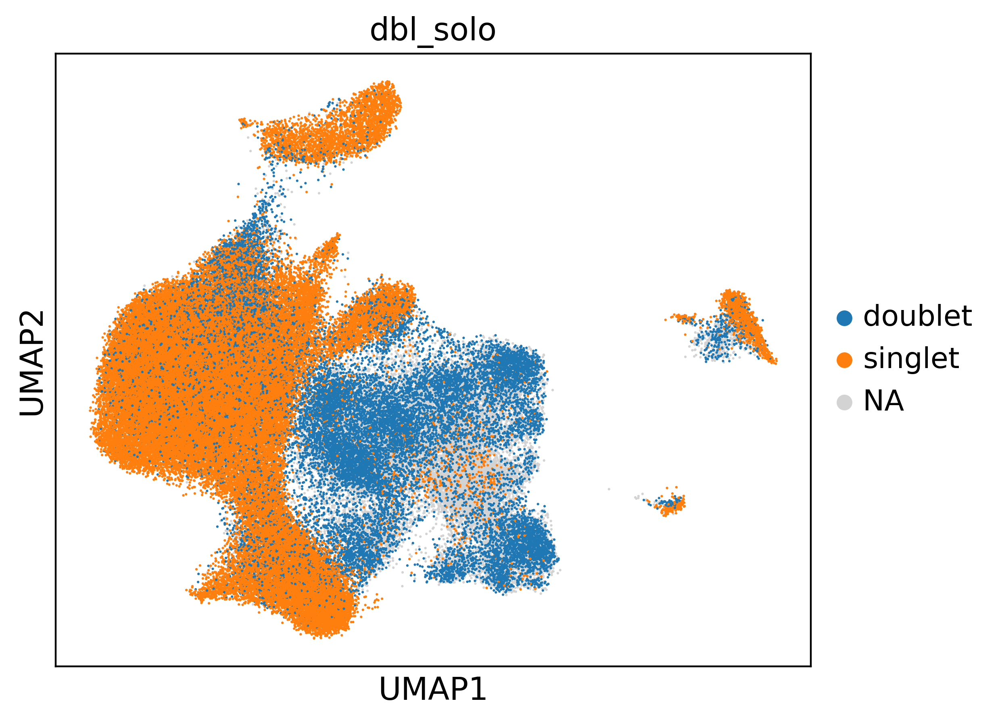

In [31]:
# note NA are souporcell doublets in the following plots
plt.rcParams['figure.figsize'] = [6, 5]
sc.pl.umap(adata, color = 'dbl_solo', size = 5)

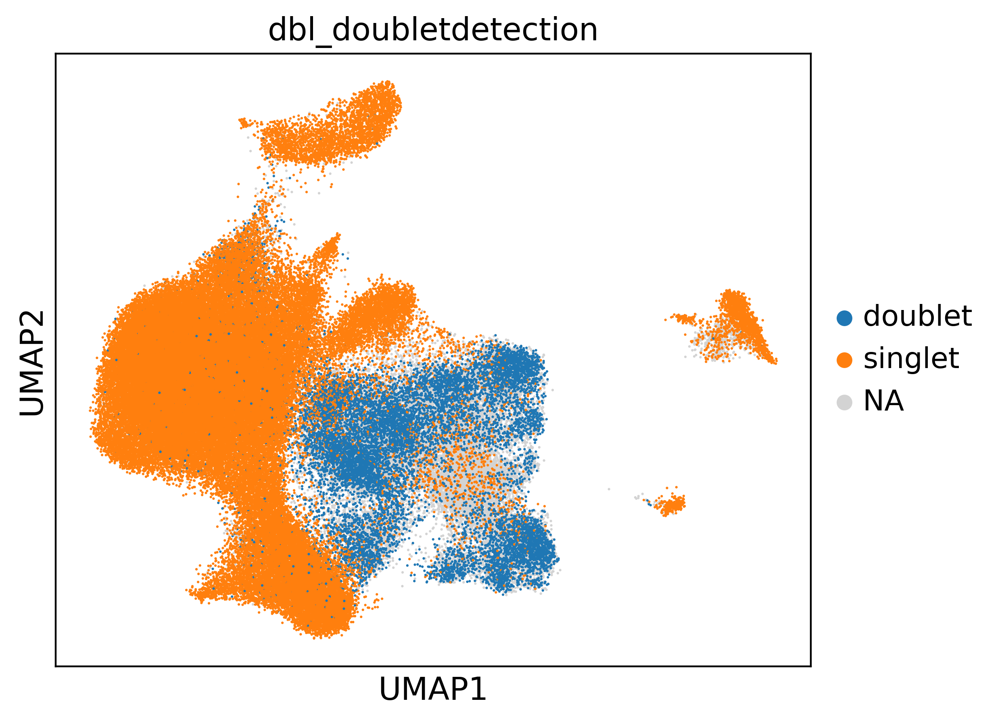

In [32]:
sc.pl.umap(adata, color = 'dbl_doubletdetection', size = 5)

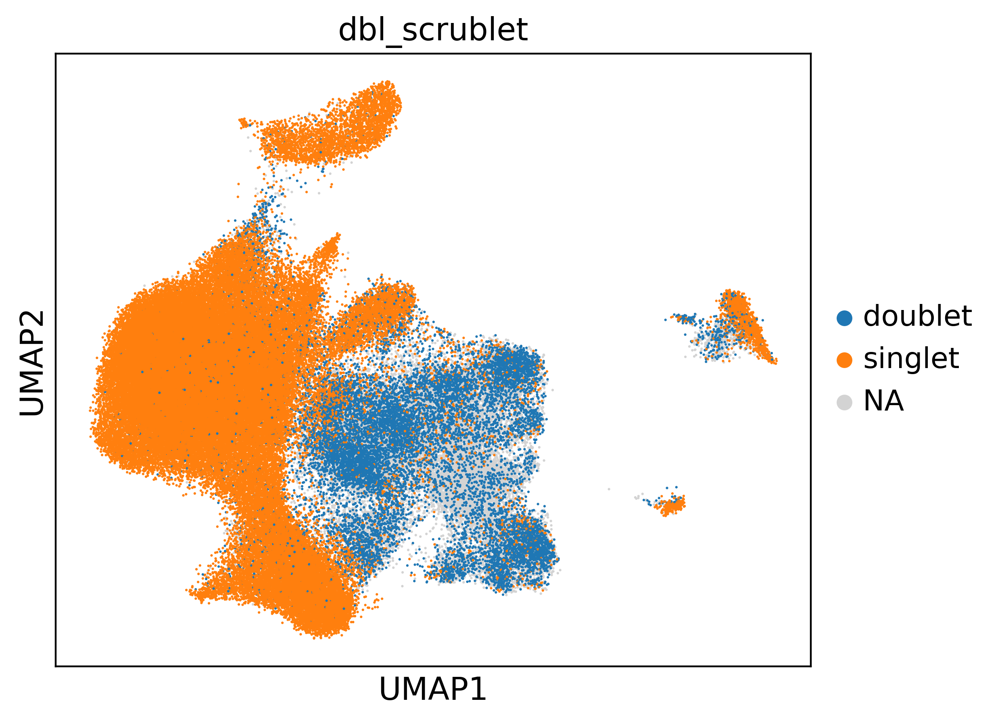

In [35]:
sc.pl.umap(adata, color = 'dbl_scrublet', size = 5)

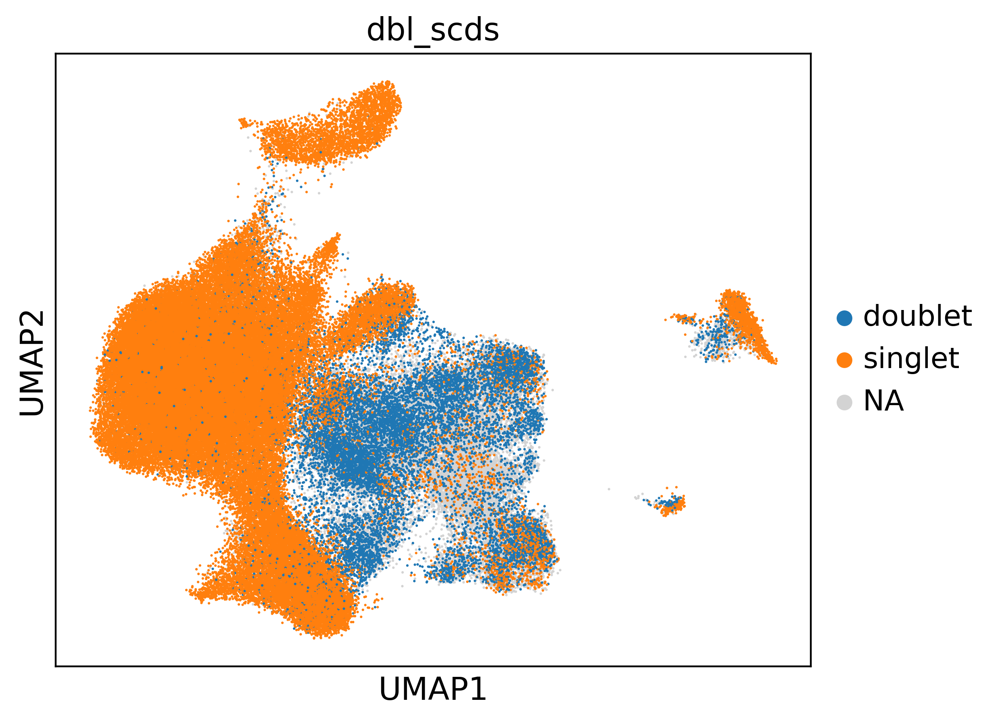

In [34]:
sc.pl.umap(adata, color = 'dbl_scds', size = 5)